### 🧠 Neural Style Transfer – Notebook 

This notebook explores **Neural Style Transfer (NST)**, a technique that blends the **content** of one image with the **style** of another using a pretrained **VGG-19** network, as proposed in:

> **"A Neural Algorithm of Artistic Style"**
> *Gatys et al., 2015 – [arXiv:1508.06576](https://arxiv.org/abs/1508.06576)*

### 💡 About This Notebook

* Adapted and inspired by code from:
  👉 [github.com/yacineMahdid/.../Neural Style Transfer (Original Version)](https://github.com/yacineMahdid/artificial-intelligence-and-machine-learning/tree/master/Neural%20Style%20Transfer%20%28Original%20Version%29)
* Focus: applying **many styles** to a **single content image** to visualize artistic variation.
* 🔄 To use your own images, simply change the file paths in the **Variables** section.
* 🚀 This notebook was run on **Kaggle** to benefit from **free GPU acceleration**.


# imports

In [ ]:
from __future__ import print_function

import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim

from PIL import Image
import matplotlib.pyplot as plt

import torchvision.transforms as transforms
import torchvision.models as models
from torchvision.utils import save_image
import copy
import os

In [56]:
import warnings
warnings.filterwarnings('ignore')

# variables

In [57]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
imsize = 1024 if torch.cuda.is_available() else 128  # use small size if no gpu
loader = transforms.Compose([transforms.Resize((imsize,imsize)),  transforms.ToTensor()]) 

In [58]:
# define paths
styles_dir = "/kaggle/input/input-images/Input/styles"
content_path = "/kaggle/input/input-images/Input/content/content.jpg"
output_dir = "/kaggle/working/output"
os.makedirs(output_dir, exist_ok=True)

# loading images

In [59]:
# Helper function
def image_loader(image_name):
    image = Image.open(image_name)
    image = loader(image).unsqueeze(0) # add batch size
    return image.to(device, torch.float)

# show images

In [60]:
unloader = transforms.ToPILImage()  # reconvert into PIL image
# Helper function to show the tensor as a PIL image
def imshow(tensor, title=None):
    image = tensor.cpu().clone()  # we clone the tensor to not do changes on it
    image = image.squeeze(0)      # remove the fake batch dimension
    image = unloader(image)
    plt.imshow(image)
    if title is not None:
        plt.title(title)

# Losses

In [61]:
class ContentLoss(nn.Module):

    def __init__(self, target,):
        super(ContentLoss, self).__init__()
        self.target = target.detach()

    def forward(self, input):
        self.loss = F.mse_loss(input, self.target)
        return input

In [62]:
# This is for the style loss
def gram_matrix(input):
    b, c, h, w = input.size()  # batch size(=1), c=channels,h=height,w=width 
    features = input.view(b * c, h * w)  
    G = torch.mm(features, features.t())  # compute the gram product
    # we 'normalize' the values of the gram matrix
    # by dividing by the number of element in each feature maps.
    # This normalization is not in the original NST paper by Gatys et al., 
    # but it’s a widely adopted best practice in modern implementations to ensure stability and better control over style contribution.
    return G.div(b * c * h * w)

# Same structure as the content loss
class StyleLoss(nn.Module):

    def __init__(self, target_feature):
        super(StyleLoss, self).__init__()
        self.target = gram_matrix(target_feature).detach()

    def forward(self, input):
        G = gram_matrix(input)
        self.loss = F.mse_loss(G, self.target)
        return input

# model

In [63]:
# Importing the VGG 19 model like in the paper (here we set it to evaluation mode)
cnn = models.vgg19(pretrained=True).features.to(device).eval()

# VGG network are normalized with special values for the mean and std
cnn_normalization_mean = torch.tensor([0.485, 0.456, 0.406]).to(device)
cnn_normalization_std = torch.tensor([0.229, 0.224, 0.225]).to(device)

In [64]:
# create a module to normalize input image so we can easily put it in a nn.Sequential
class Normalization(nn.Module):
    def __init__(self, mean, std):
        super(Normalization, self).__init__()
        # .view the mean and std to make them [C x 1 x 1] so that they can
        # directly work with image Tensor of shape [B x C x H x W].
        self.mean = torch.tensor(mean).view(-1, 1, 1)
        self.std = torch.tensor(std).view(-1, 1, 1)

    def forward(self, img):
        # normalize img
        return (img - self.mean) / self.std

In [65]:
# desired depth layers to compute style/content losses :
content_layers_default = ['conv_4']
style_layers_default = ['conv_1', 'conv_2', 'conv_3', 'conv_4', 'conv_5']

In [66]:
def get_style_model_and_losses(cnn, normalization_mean, normalization_std,
                               style_img, content_img,
                               content_layers=content_layers_default,
                               style_layers=style_layers_default):
    cnn = copy.deepcopy(cnn)

    # normalization module
    normalization = Normalization(normalization_mean, normalization_std).to(device)

    # just in order to have an iterable access to or list of content/syle
    # losses
    content_losses = []
    style_losses = []

    # assuming that cnn is a nn.Sequential, so we make a new nn.Sequential
    # to put in modules that are supposed to be activated sequentially
    model = nn.Sequential(normalization)

    i = 0  # increment every time we see a conv
    for layer in cnn.children():
        if isinstance(layer, nn.Conv2d):
            i += 1
            name = 'conv_{}'.format(i)
        elif isinstance(layer, nn.ReLU):
            name = 'relu_{}'.format(i)
            # The in-place version doesn't play very nicely with the ContentLoss
            # and StyleLoss we insert below. So we replace with out-of-place
            # ones here.
            layer = nn.ReLU(inplace=False)
        elif isinstance(layer, nn.MaxPool2d):
            name = 'pool_{}'.format(i)
        elif isinstance(layer, nn.BatchNorm2d):
            name = 'bn_{}'.format(i)
        else:
            raise RuntimeError('Unrecognized layer: {}'.format(layer.__class__.__name__))

        model.add_module(name, layer)

        if name in content_layers:
            # add content loss:
            target = model(content_img).detach()
            content_loss = ContentLoss(target)
            model.add_module("content_loss_{}".format(i), content_loss)
            content_losses.append(content_loss)

        if name in style_layers:
            # add style loss:
            target_feature = model(style_img).detach()
            style_loss = StyleLoss(target_feature)
            model.add_module("style_loss_{}".format(i), style_loss)
            style_losses.append(style_loss)

    # now we trim off the layers after the last content and style losses
    for i in range(len(model) - 1, -1, -1):
        if isinstance(model[i], ContentLoss) or isinstance(model[i], StyleLoss):
            break

    model = model[:(i + 1)]

    return model, style_losses, content_losses


# Train Loop

In [74]:
# This will run the neural style transfer
# It will create image that goes above 1 or below 0, however it will be normalized
def run_style_transfer(cnn, normalization_mean, normalization_std,
                       content_img, style_img, input_img, num_steps=300,style_name='style_0',
                       style_weight=1000000, content_weight=1): # we put content_weight=1 because we rae using the content image as input
    """Run the style transfer."""
    print('Building the style transfer model..')
    model, style_losses, content_losses = get_style_model_and_losses(cnn,
        normalization_mean, normalization_std, style_img, content_img)
    optimizer = get_input_optimizer(input_img)

    print('Optimizing..')
    run = [0]
    losses = []
    while run[0] <= num_steps :

        def closure():
            # correct the values of updated input image
            input_img.data.clamp_(0, 1)

            optimizer.zero_grad()
            model(input_img)
            style_score = 0
            content_score = 0

            for sl in style_losses:
                style_score += sl.loss
            for cl in content_losses:
                content_score += cl.loss

            style_score *= style_weight
            content_score *= content_weight

            loss = style_score + content_score
            losses.append(loss)
            loss.backward()

            run[0] += 1
            if run[0] % 50 == 0:
                plt.figure()
                imshow(input_img,"run {}:".format(run))
                plt.show()
                print('Style Loss : {:4f} Content Loss: {:4f}'.format(
                    style_score.item(), content_score.item()))
                
                save_image(input_img,os.path.join(output_dir, style_name+str(run[0])+'.png'))
                

            return style_score + content_score
            
        if run[0] % 50 == 0 and len(losses)>1 and losses[-1]>losses[-2]: # stop if perfomance gets worse
            break
            
        optimizer.step(closure)

    # a last correction to have the tensors between 0 and 1
    input_img.data.clamp_(0, 1)

    return input_img

In [70]:
def get_input_optimizer(input_img):
    # this line to show that input is a parameter that requires a gradient
    optimizer = optim.LBFGS([input_img.requires_grad_()])
    return optimizer

# Run the code

Loaded: style_3
Building the style transfer model..
Optimizing..


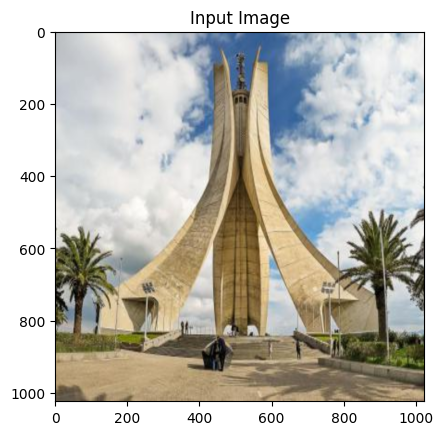

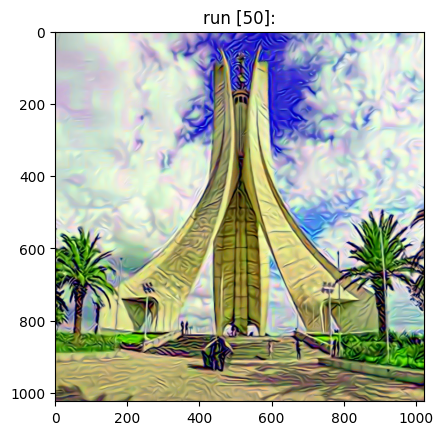

Style Loss : 268.101654 Content Loss: 11.215130


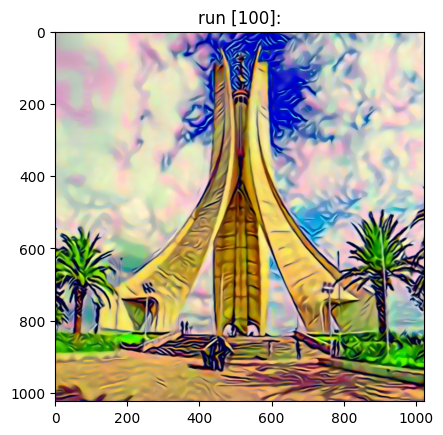

Style Loss : 103.932831 Content Loss: 12.950723


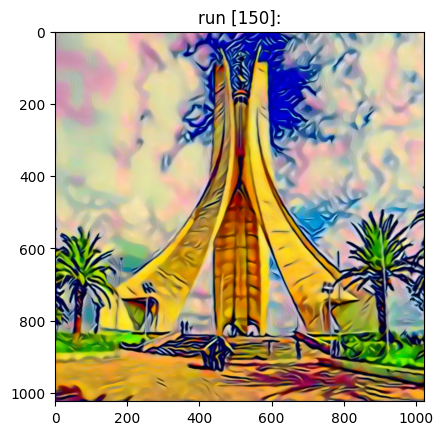

Style Loss : 48.733326 Content Loss: 13.352168


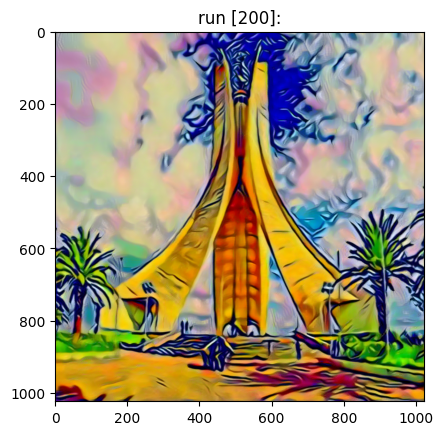

Style Loss : 24.505455 Content Loss: 12.848025


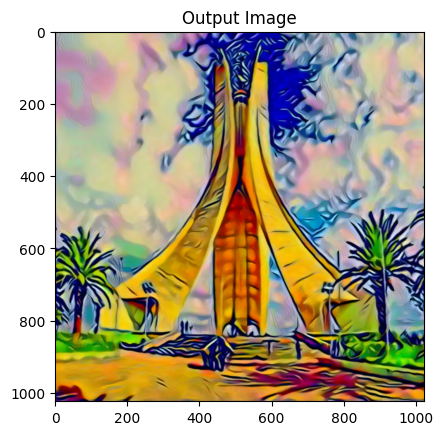

Loaded: style_4
Building the style transfer model..
Optimizing..


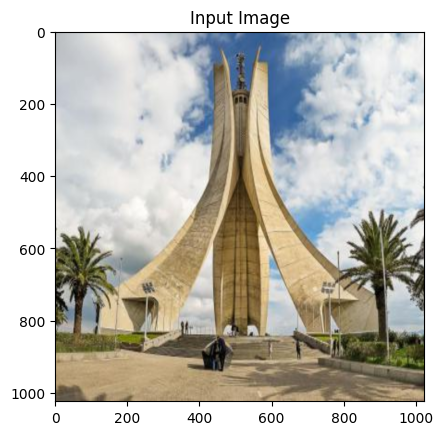

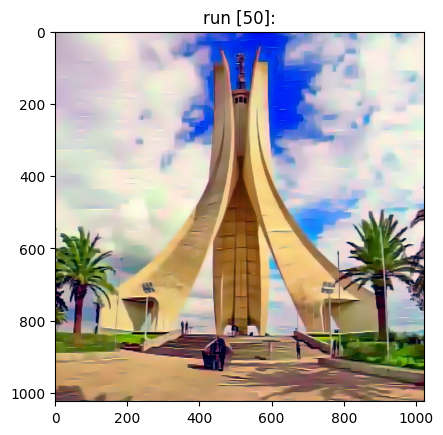

Style Loss : 171.187973 Content Loss: 7.448568


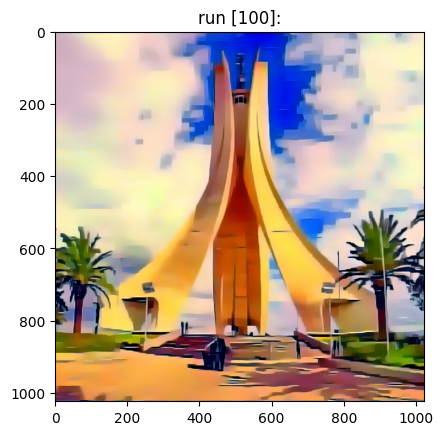

Style Loss : 61.826141 Content Loss: 8.394615


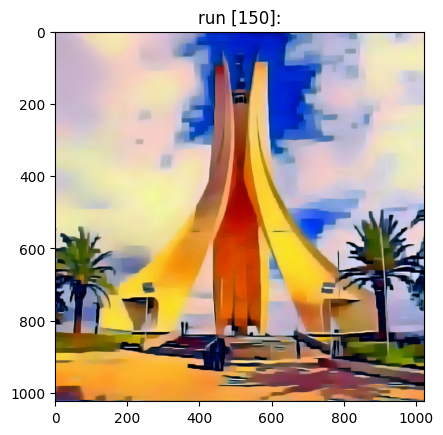

Style Loss : 35.099934 Content Loss: 8.462130


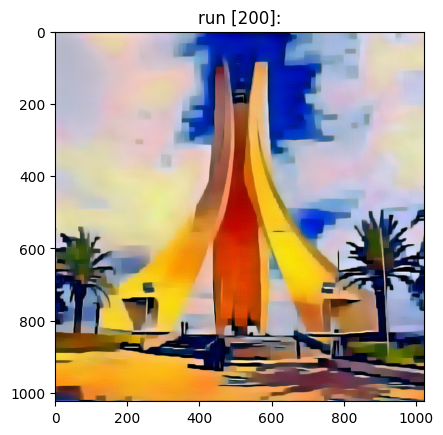

Style Loss : 25.080200 Content Loss: 8.923409


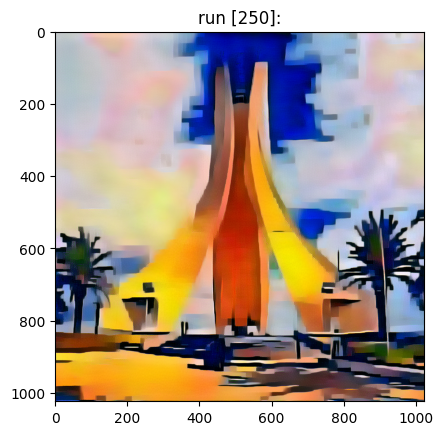

Style Loss : 20.350897 Content Loss: 9.317319


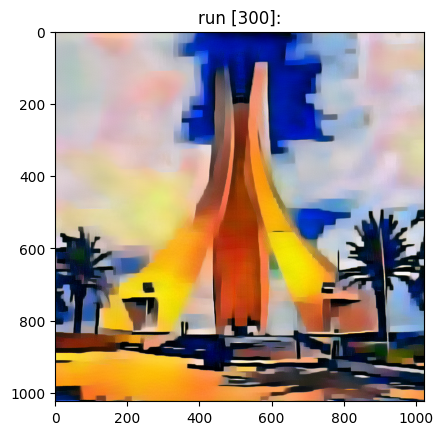

Style Loss : 13.987238 Content Loss: 8.954977


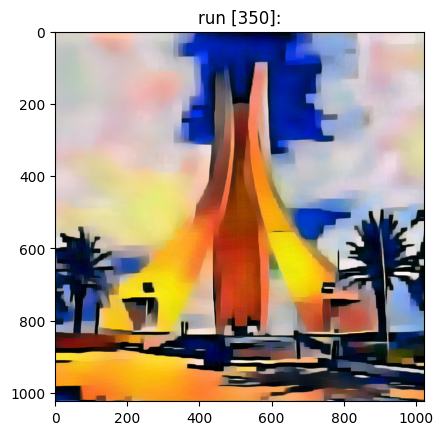

Style Loss : 10.101166 Content Loss: 8.695687


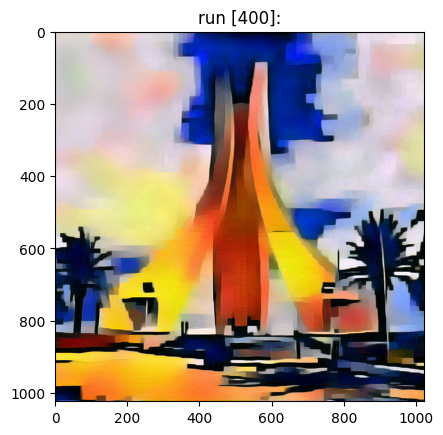

Style Loss : 49.165192 Content Loss: 9.077017


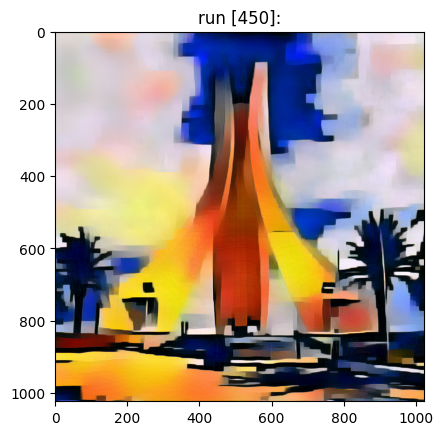

Style Loss : 6.231476 Content Loss: 8.138304


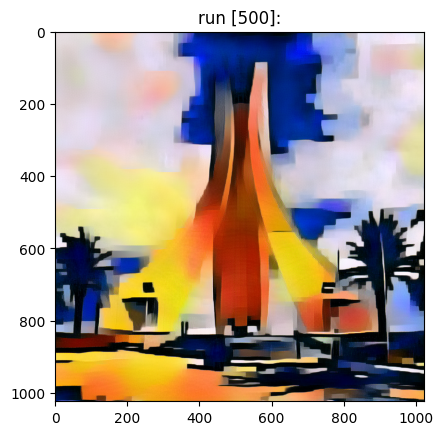

Style Loss : 5.339015 Content Loss: 8.410295


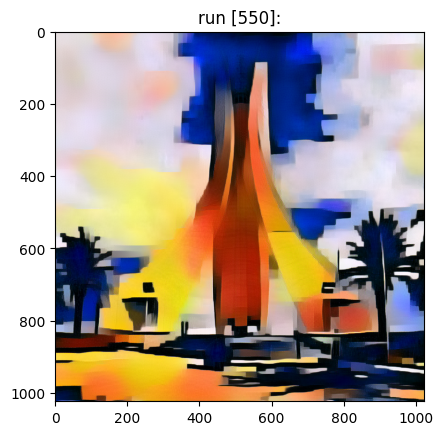

Style Loss : 4.377975 Content Loss: 8.019196


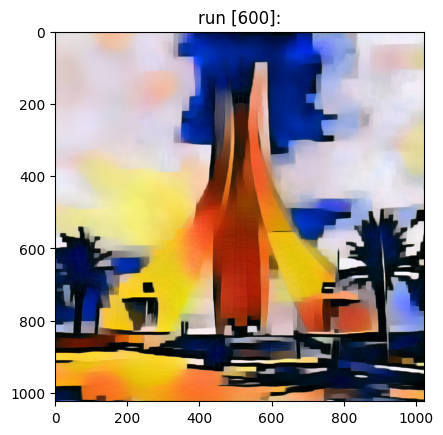

Style Loss : 3.856989 Content Loss: 7.670474


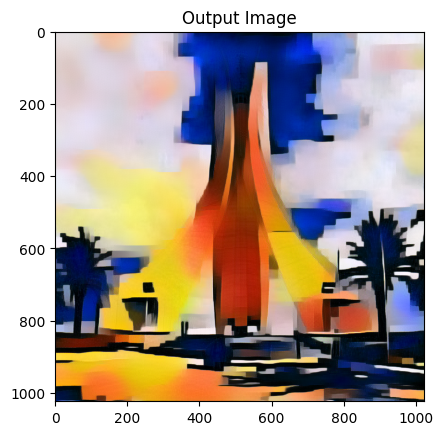

Loaded: style_5
Building the style transfer model..
Optimizing..


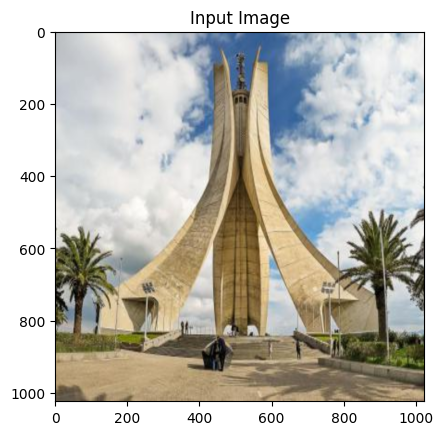

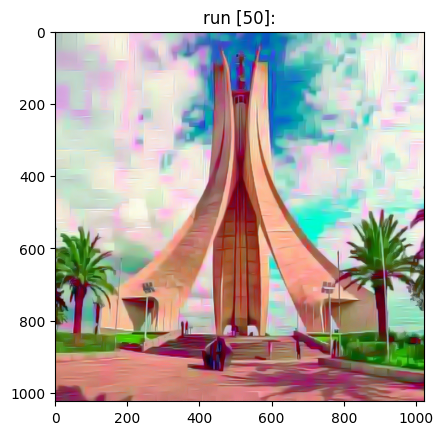

Style Loss : 528.328857 Content Loss: 7.427509


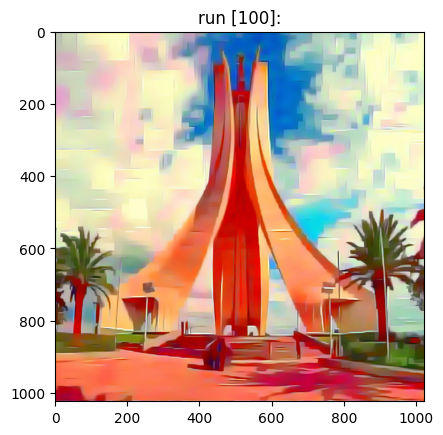

Style Loss : 109.571747 Content Loss: 8.767090


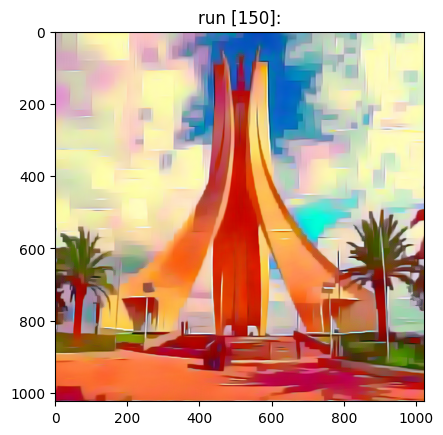

Style Loss : 54.464783 Content Loss: 9.122575


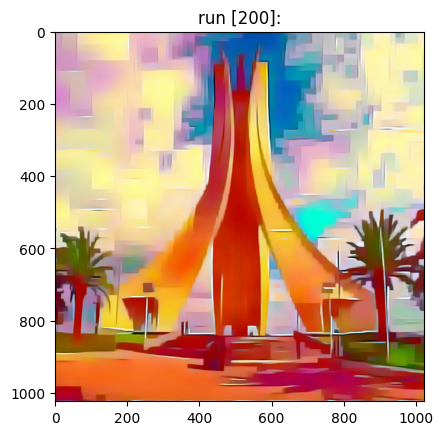

Style Loss : 30.162636 Content Loss: 9.329777


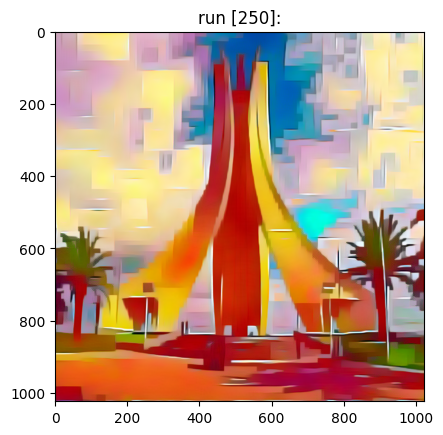

Style Loss : 19.806368 Content Loss: 9.333090


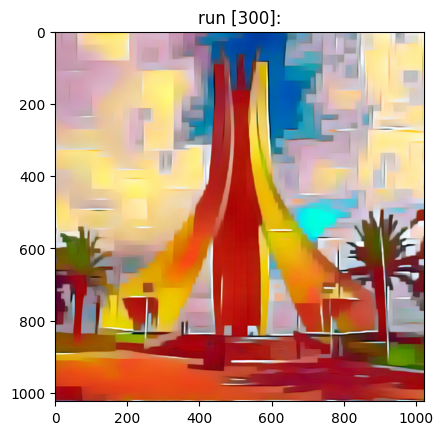

Style Loss : 15.503789 Content Loss: 9.397390


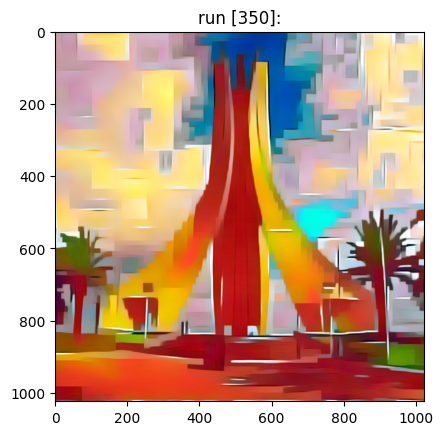

Style Loss : 12.375984 Content Loss: 9.391554


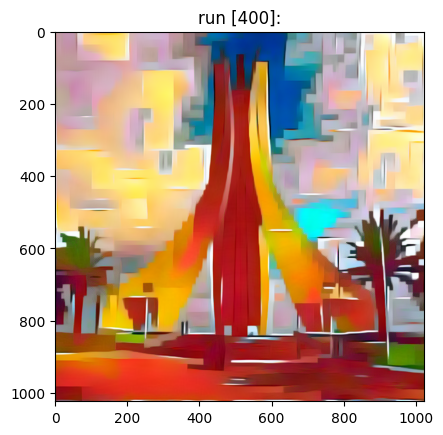

Style Loss : 10.544475 Content Loss: 9.436951


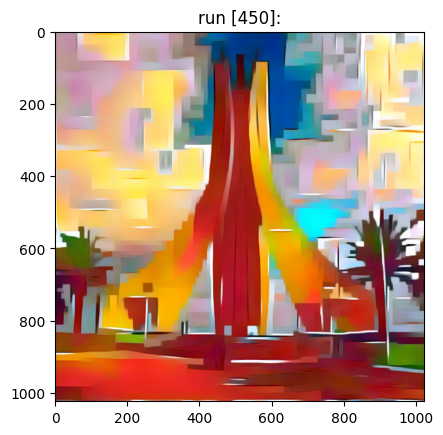

Style Loss : 9.294883 Content Loss: 9.546957


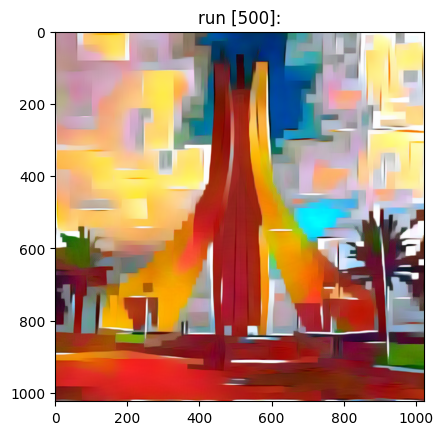

Style Loss : 8.318645 Content Loss: 9.654480


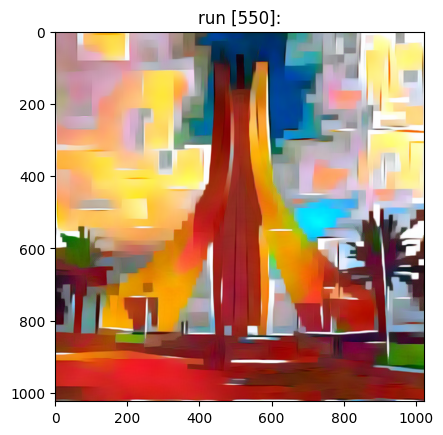

Style Loss : 7.516946 Content Loss: 9.843296


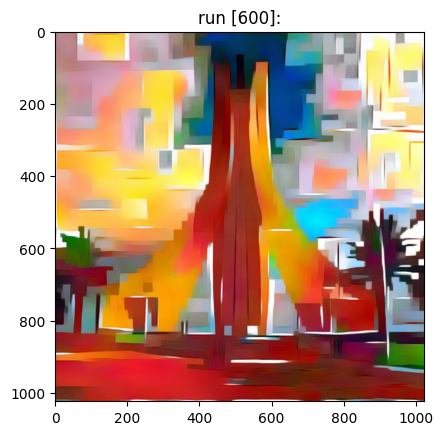

Style Loss : 11.246341 Content Loss: 9.885513


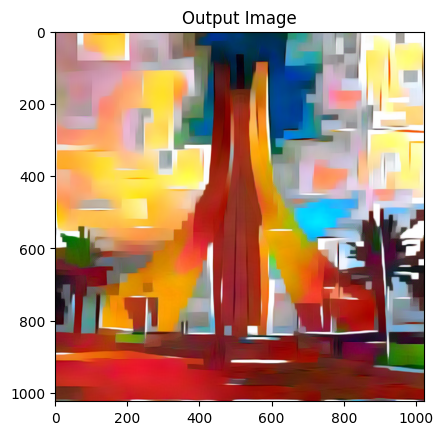

Loaded: style_1
Building the style transfer model..
Optimizing..


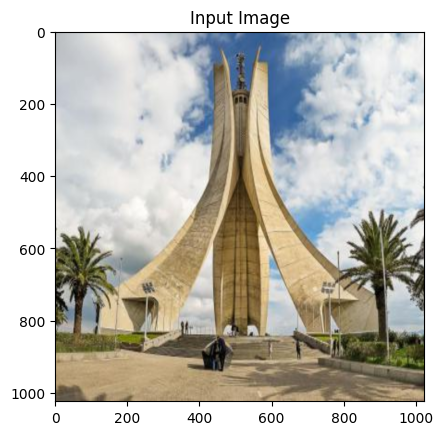

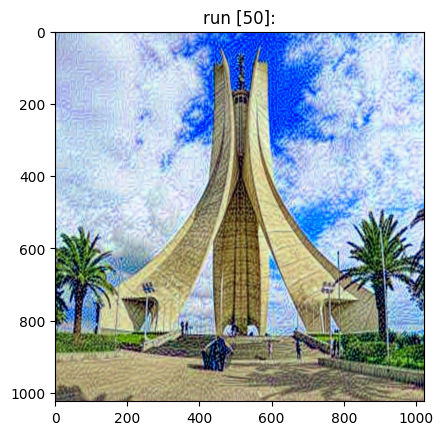

Style Loss : 174.306259 Content Loss: 11.182772


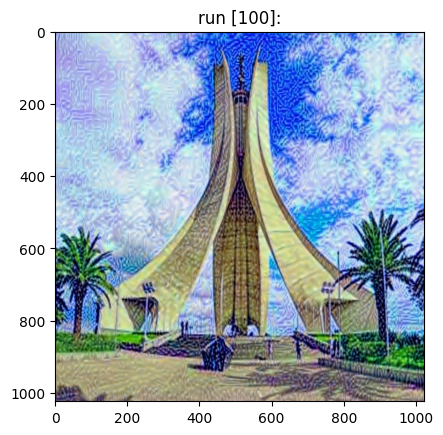

Style Loss : 61.977322 Content Loss: 11.515396


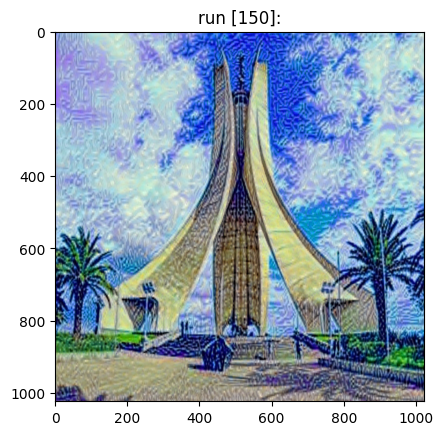

Style Loss : 24.632092 Content Loss: 11.591410


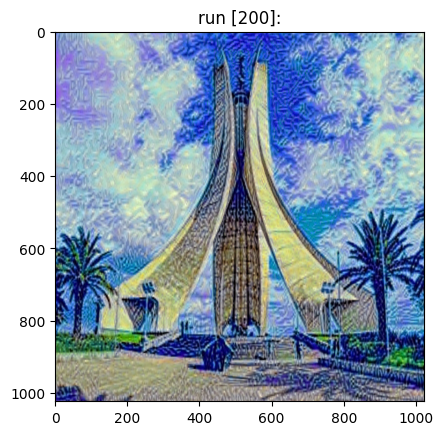

Style Loss : 11.382470 Content Loss: 11.355757


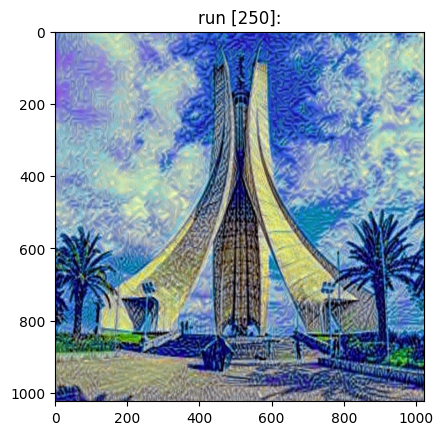

Style Loss : 6.601679 Content Loss: 10.771733


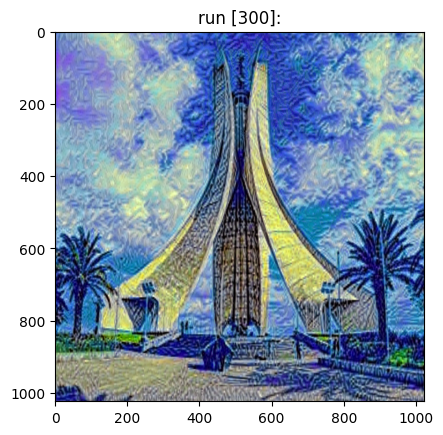

Style Loss : 4.322754 Content Loss: 10.143204


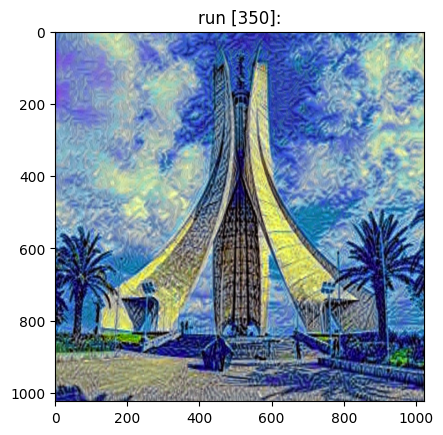

Style Loss : 3.262193 Content Loss: 9.625359


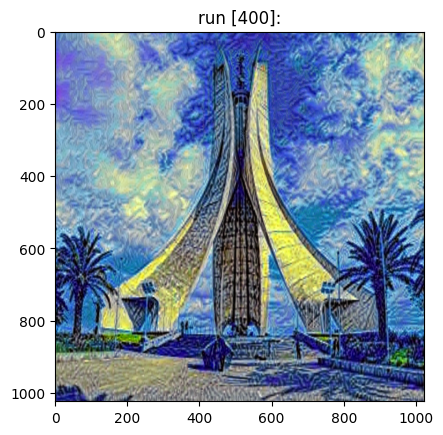

Style Loss : 2.672784 Content Loss: 9.209221


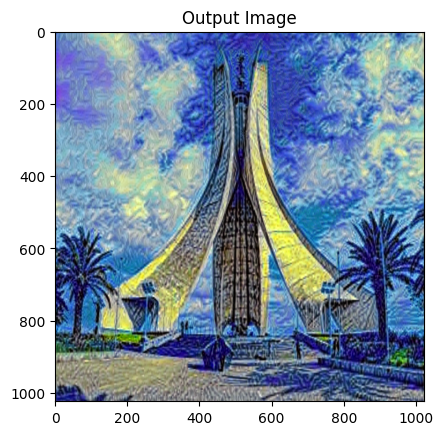

Loaded: style_6
Building the style transfer model..
Optimizing..


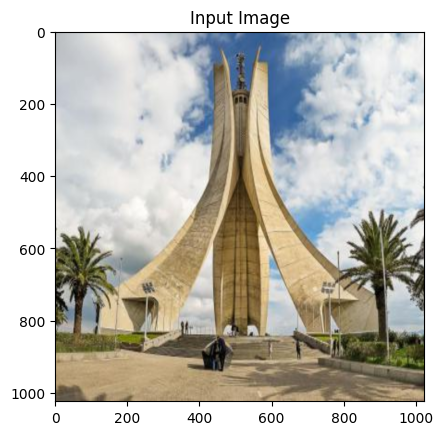

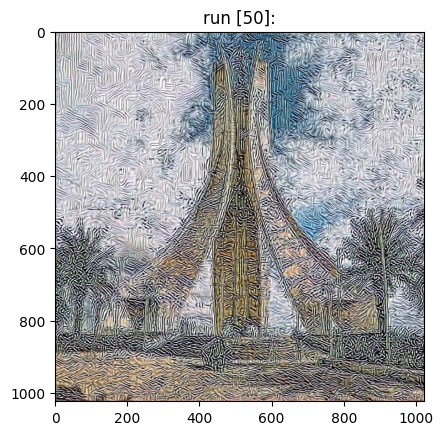

Style Loss : 1209.843384 Content Loss: 77.601974


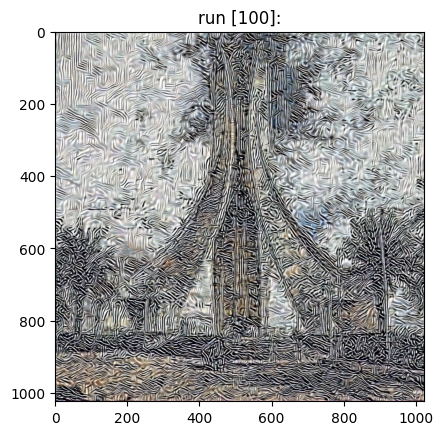

Style Loss : 194.286575 Content Loss: 77.585876


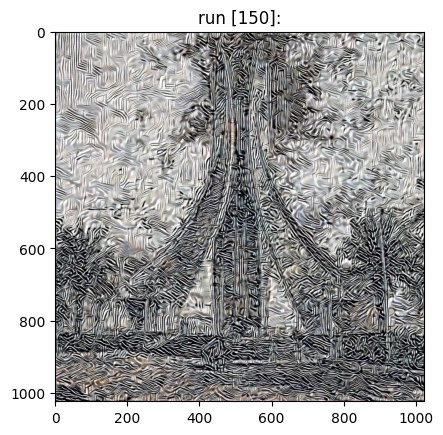

Style Loss : 77.528984 Content Loss: 77.274345


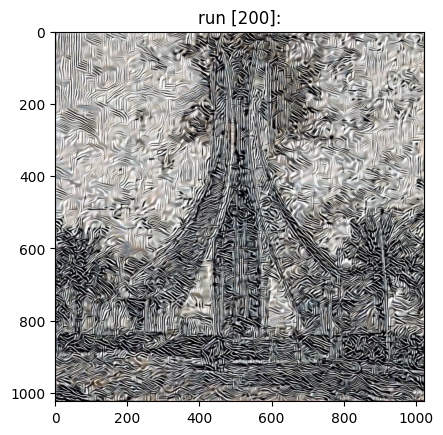

Style Loss : 37.425835 Content Loss: 77.272667


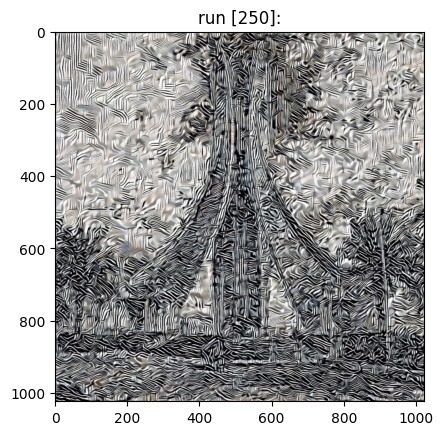

Style Loss : 26.018236 Content Loss: 76.873108


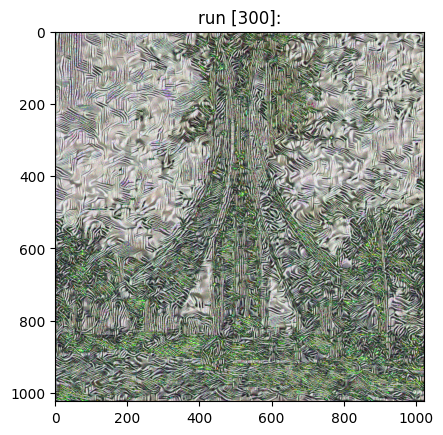

Style Loss : 187392.296875 Content Loss: 85.857407


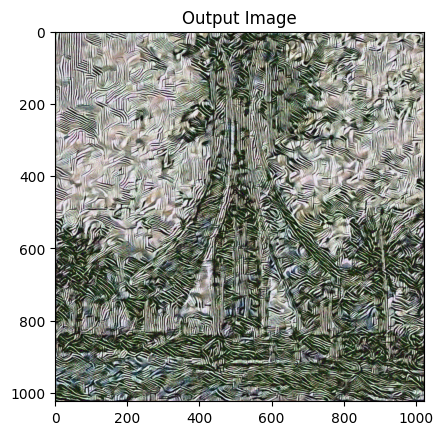

Loaded: style_2
Building the style transfer model..
Optimizing..


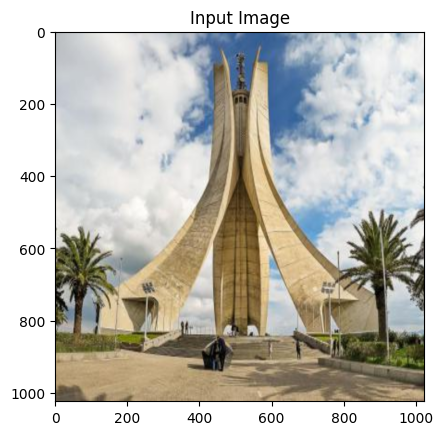

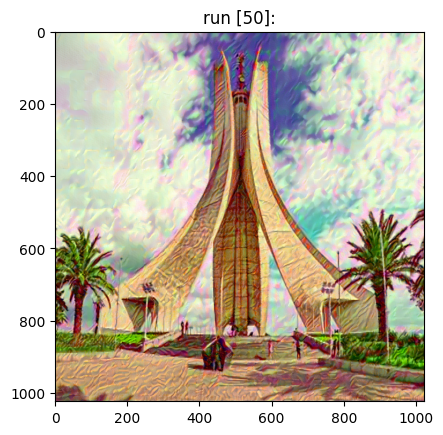

Style Loss : 229.695648 Content Loss: 12.195700


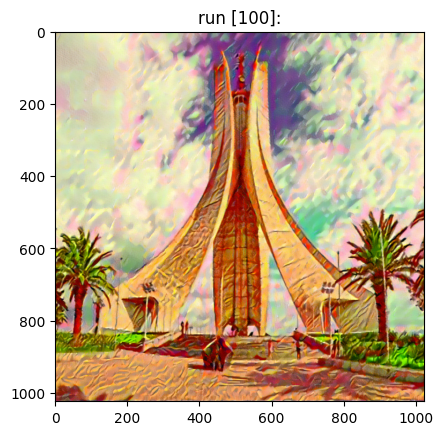

Style Loss : 71.229538 Content Loss: 12.989313


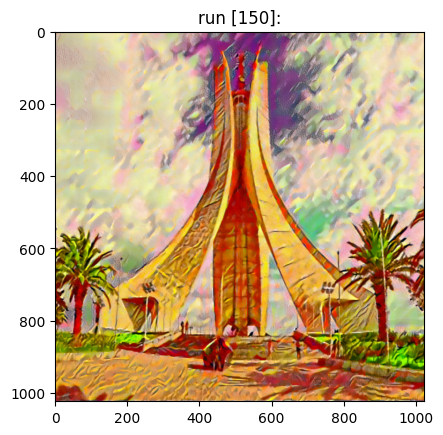

Style Loss : 36.200554 Content Loss: 12.703405


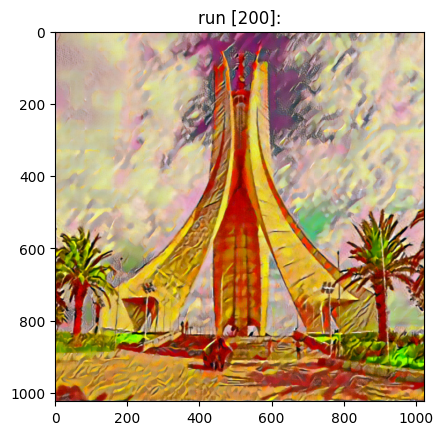

Style Loss : 16.218229 Content Loss: 12.475004


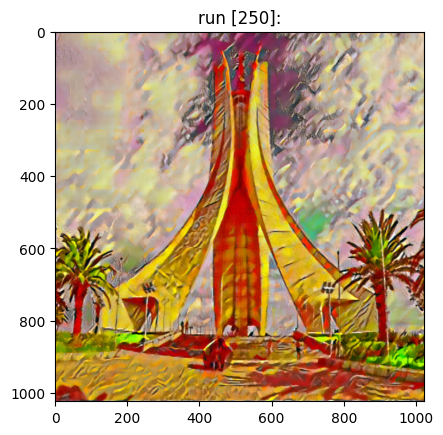

Style Loss : 9.161339 Content Loss: 11.900612


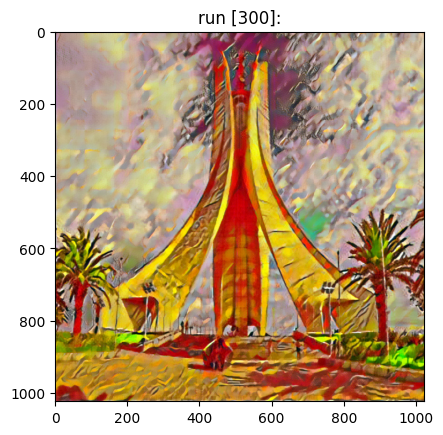

Style Loss : 5.910578 Content Loss: 11.253138


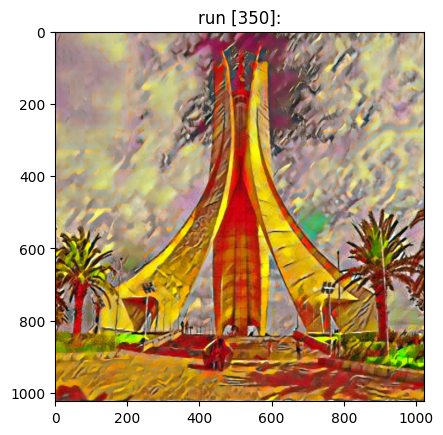

Style Loss : 4.017120 Content Loss: 10.830185


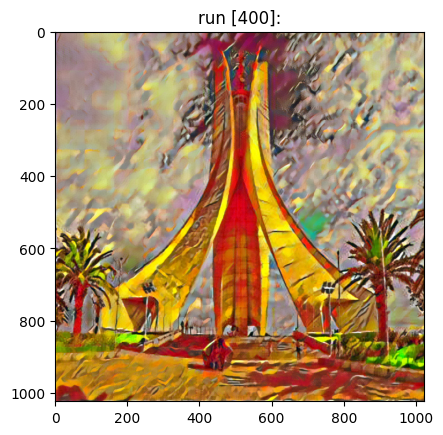

Style Loss : 2.896668 Content Loss: 10.493686


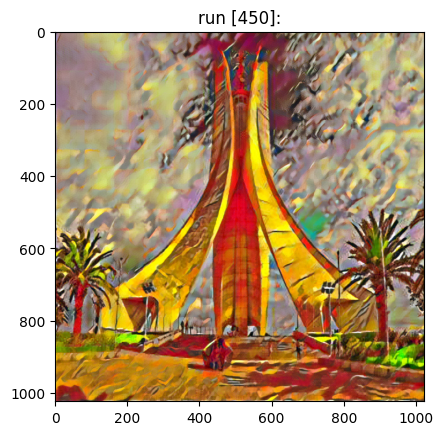

Style Loss : 2.141907 Content Loss: 10.190437


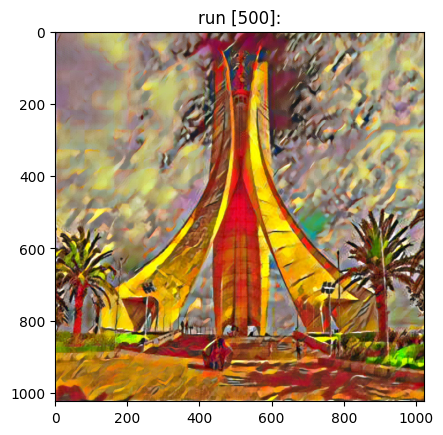

Style Loss : 1.658730 Content Loss: 9.953711


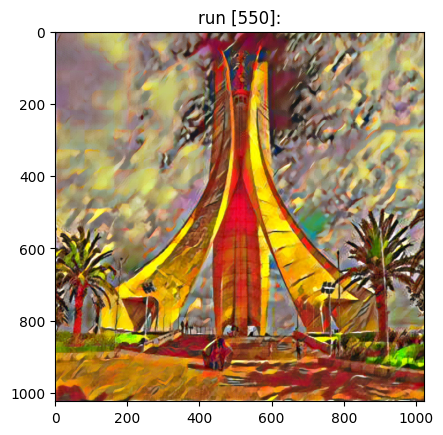

Style Loss : 1.281674 Content Loss: 9.785494


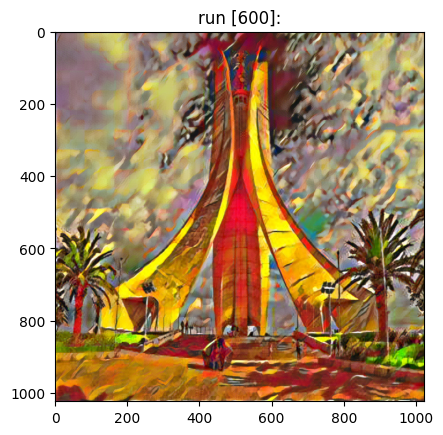

Style Loss : 1.016815 Content Loss: 9.646017


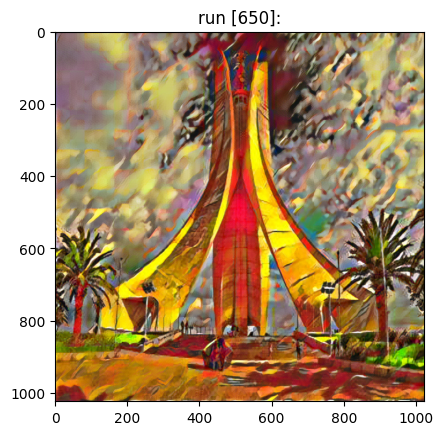

Style Loss : 0.837569 Content Loss: 9.529316


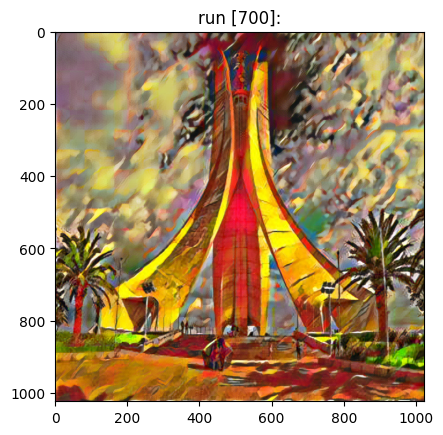

Style Loss : 0.713708 Content Loss: 9.426821


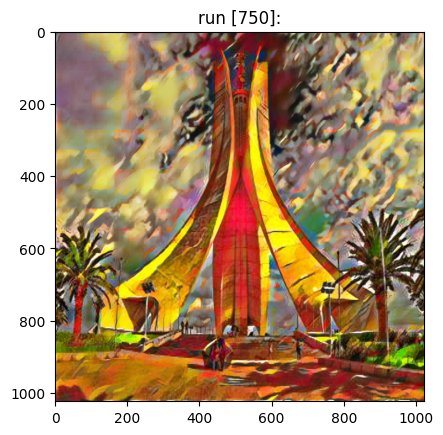

Style Loss : 0.664657 Content Loss: 9.335495


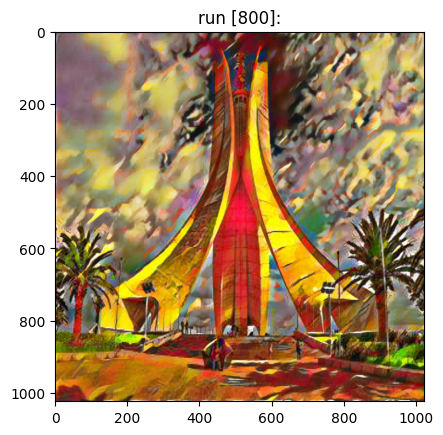

Style Loss : 0.570061 Content Loss: 9.268211


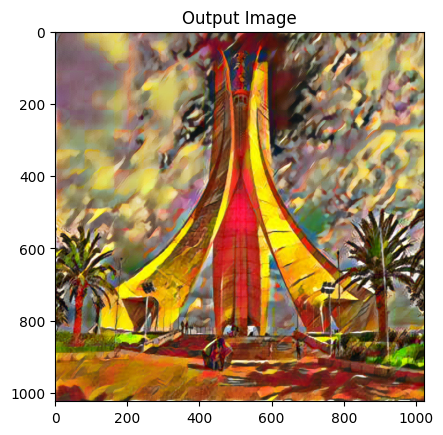

In [75]:
content_img = image_loader(content_path)
# Loop through all style images 
for style in os.listdir(styles_dir):
        style_path = os.path.join(styles_dir, style)
        style_img = image_loader(style_path)
        style_name = style.split('.')[0]
        print(f"Loaded: {style_name}")
        os.makedirs(os.path.join(output_dir, style_name), exist_ok=True)
        input_img = content_img.clone()
        plt.figure()
        imshow(input_img, title='Input Image')
        output = run_style_transfer(cnn, cnn_normalization_mean, cnn_normalization_std,
                            content_img, style_img, input_img, num_steps=800,style_name=style_name)

        plt.figure()
        imshow(output, title='Output Image')
        plt.show()
        

In [76]:
import shutil

shutil.make_archive("/kaggle/working/outputZip", 'zip', "/kaggle/working/output")

'/kaggle/working/outputZip.zip'